In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Apr 21 07:21:25 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


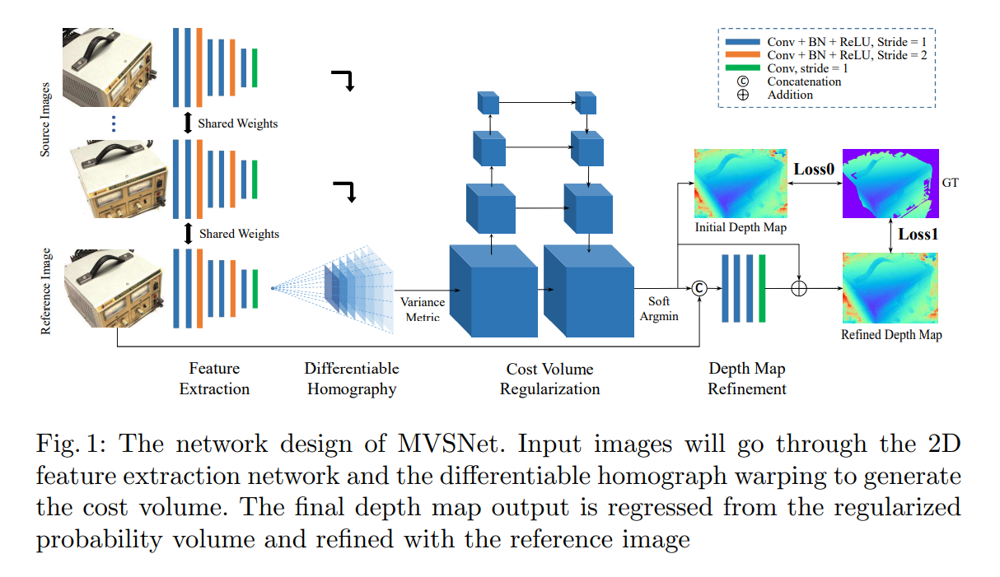

# [Link to the paper (MVSNet)](https://arxiv.org/pdf/1804.02505.pdf)


## Extracting the Deep Features

### An eight-layer 2D CNN is applied, where the strides of layer 3 and 6 are set to two to divide the feature towers into three scales. Within each scale, two convolutional layers are applied to extract the higher-level image representation. Each convolutional layer is followed by a batch-normalization (BN) layer and a rectified linear unit (ReLU) except for the last layer. Also, similar to common matching tasks, parameters are shared among all feature towers for efficient learning. The outputs of the 2D network are N 32-channel feature maps downsized by four in each dimension compared with input images. It is noteworthy that though the image frame is downsized after feature extraction, the original neighboring information of each remaining pixel has already been encoded into the 32-channel pixel descriptor, which prevents dense matching from losing useful context information. Compared with simply performing dense matching on original images, the extracted feature maps significantly boost the reconstruction quality

## Cost Volume

### The core step to bridge the 2D feature extraction and the 3D regularization networks, the warping operation is implemented in differentiable manner, which enables end-to-end training of depth map inference.

In [3]:
!pip --quiet install tensorboardX pytorch-forecasting kornia plyfile

     |████████████████████████████████| 125 kB 36.7 MB/s 
     |████████████████████████████████| 127 kB 77.7 MB/s 
     |████████████████████████████████| 493 kB 86.2 MB/s 
     |████████████████████████████████| 308 kB 84.0 MB/s 
     |████████████████████████████████| 582 kB 93.2 MB/s 
     |████████████████████████████████| 81 kB 11.3 MB/s 
     |████████████████████████████████| 210 kB 82.9 MB/s 
     |████████████████████████████████| 136 kB 77.2 MB/s 
     |████████████████████████████████| 596 kB 88.8 MB/s 
     |████████████████████████████████| 408 kB 92.3 MB/s 
     |████████████████████████████████| 1.1 MB 92.2 MB/s 
     |████████████████████████████████| 94 kB 3.9 MB/s 
     |████████████████████████████████| 144 kB 66.5 MB/s 
     |████████████████████████████████| 271 kB 76.1 MB/s 
     |████████████████████████████████| 78 kB 6.9 MB/s 
     |████████████████████████████████| 146 kB 5.9 MB/s 
     |████████████████████████████████| 49 kB 7.4 MB/s 
     |████████████████

In [4]:
%load_ext tensorboard
%tensorboard --logdir=/content/drive/MyDrive/dissertation/checkpoints

<IPython.core.display.Javascript object>

In [ ]:
!git clone --progress --verbose  https://github.com/Gaurav-Gosain/dissertation_data.git

Cloning into 'dissertation_data'...
POST git-upload-pack (165 bytes)
remote: Enumerating objects: 54636, done.
remote: Counting objects: 100% (3238/3238), done.
remote: Compressing objects: 100% (3199/3199), done.
remote: Total 54636 (delta 32), reused 3238 (delta 32), pack-reused 51398
Receiving objects: 100% (54636/54636), 19.54 GiB | 31.77 MiB/s, done.
Resolving deltas: 100% (881/881), done.
Checking out files: 100% (55105/55105), done.


In [ ]:
import argparse
import os
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torch.autograd import Variable
import torchvision.utils as vutils
import torch.nn.functional as F
import numpy as np
import time
from tensorboardX import SummaryWriter
import gc
import sys
import datetime
import cv2
import re
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from tqdm.notebook import tqdm
import warnings
from torchvision import transforms as T
import math
from torch.optim.optimizer import Optimizer, required
import itertools as it
from torch.optim.lr_scheduler import _LRScheduler
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torchvision.utils as vutils
# optimizer
from torch.optim import SGD, Adam, RAdam
from pytorch_forecasting.optim import Ranger
# scheduler
from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR, LambdaLR
from kornia.utils import create_meshgrid
# for point cloud fusion
from numba import jit
from plyfile import PlyData, PlyElement


warnings.filterwarnings("ignore")

cudnn.benchmark = True

gc.enable()

In [ ]:
# torch.no_grad wrapper for functions
def make_nograd_func(func):
    def wrapper(*f_args, **f_kwargs):
        with torch.no_grad():
            ret = func(*f_args, **f_kwargs)
        return ret

    return wrapper


# convert a function into recursive style to handle nested dict/list/tuple variables
def make_recursive_func(func):
    def wrapper(vars):
        if isinstance(vars, list):
            return [wrapper(x) for x in vars]
        elif isinstance(vars, tuple):
            return tuple([wrapper(x) for x in vars])
        elif isinstance(vars, dict):
            return {k: wrapper(v) for k, v in vars.items()}
        else:
            return func(vars)

    return wrapper


@make_recursive_func
def tensor2float(vars):
    if isinstance(vars, float):
        return vars
    elif isinstance(vars, torch.Tensor):
        return vars.data.item()
    else:
        raise NotImplementedError(
            "invalid input type {} for tensor2float".format(type(vars))
        )


@make_recursive_func
def tensor2numpy(vars):
    if isinstance(vars, np.ndarray):
        return vars
    elif isinstance(vars, torch.Tensor):
        return vars.detach().cpu().numpy().copy()
    else:
        raise NotImplementedError(
            "invalid input type {} for tensor2numpy".format(type(vars))
        )


@make_recursive_func
def tocuda(vars):
    if isinstance(vars, torch.Tensor):
        return vars.cuda()
    elif isinstance(vars, str):
        return vars
    else:
        raise NotImplementedError(
            "invalid input type {} for tensor2numpy".format(type(vars))
        )


def save_scalars(logger, mode, scalar_dict, global_step):
    scalar_dict = tensor2float(scalar_dict)
    for key, value in scalar_dict.items():
        if not isinstance(value, (list, tuple)):
            name = "{}/{}".format(mode, key)
            logger.add_scalar(name, value, global_step)
        else:
            for idx in range(len(value)):
                name = "{}/{}_{}".format(mode, key, idx)
                logger.add_scalar(name, value[idx], global_step)


def save_images(logger, mode, images_dict, global_step):
    images_dict = tensor2numpy(images_dict)

    def preprocess(name, img):
        if not (len(img.shape) == 3 or len(img.shape) == 4):
            raise NotImplementedError(
                "invalid img shape {}:{} in save_images".format(name, img.shape)
            )
        if len(img.shape) == 3:
            img = img[:, np.newaxis, :, :]
        img = torch.from_numpy(img[:1])
        return vutils.make_grid(img, padding=0, nrow=1, normalize=True, scale_each=True)

    for key, value in images_dict.items():
        if not isinstance(value, (list, tuple)):
            name = "{}/{}".format(mode, key)
            logger.add_image(name, preprocess(name, value), global_step)
        else:
            for idx in range(len(value)):
                name = "{}/{}_{}".format(mode, key, idx)
                logger.add_image(name, preprocess(name, value[idx]), global_step)


class DictAverageMeter(object):
    def __init__(self):
        self.data = {}
        self.count = 0

    def update(self, new_input):
        self.count += 1
        if len(self.data) == 0:
            for k, v in new_input.items():
                if not isinstance(v, float):
                    raise NotImplementedError("invalid data {}: {}".format(k, type(v)))
                self.data[k] = v
        else:
            for k, v in new_input.items():
                if not isinstance(v, float):
                    raise NotImplementedError("invalid data {}: {}".format(k, type(v)))
                self.data[k] += v

    def mean(self):
        return {k: v / self.count for k, v in self.data.items()}


# a wrapper to compute metrics for each image individually
def compute_metrics_for_each_image(metric_func):
    def wrapper(depth_est, depth_gt, mask, *args):
        batch_size = depth_gt.shape[0]
        results = []
        # compute result one by one
        for idx in range(batch_size):
            ret = metric_func(depth_est[idx], depth_gt[idx], mask[idx], *args)
            results.append(ret)
        return torch.stack(results).mean()

    return wrapper


@make_nograd_func
@compute_metrics_for_each_image
def Thres_metrics(depth_est, depth_gt, mask, thres):
    assert isinstance(thres, (int, float))
    depth_est, depth_gt = depth_est[mask], depth_gt[mask]
    errors = torch.abs(depth_est - depth_gt)
    err_mask = errors > thres
    return torch.mean(err_mask.float())


# NOTE: please do not use this to build up training loss
@make_nograd_func
@compute_metrics_for_each_image
def AbsDepthError_metrics(depth_est, depth_gt, mask):
    depth_est, depth_gt = depth_est[mask], depth_gt[mask]
    return torch.mean((depth_est - depth_gt).abs())


In [ ]:
class ConvBnReLU(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, pad=1):
        super(ConvBnReLU, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels,
                              kernel_size, stride=stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        return F.relu(self.bn(self.conv(x)), inplace=True)


class ConvBn(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, pad=1):
        super(ConvBn, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels,
                              kernel_size, stride=stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        return self.bn(self.conv(x))


class ConvBnReLU3D(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, pad=1):
        super(ConvBnReLU3D, self).__init__()
        self.conv = nn.Conv3d(in_channels, out_channels,
                              kernel_size, stride=stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm3d(out_channels)

    def forward(self, x):
        return F.relu(self.bn(self.conv(x)), inplace=True)


class ConvBn3D(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, pad=1):
        super(ConvBn3D, self).__init__()
        self.conv = nn.Conv3d(in_channels, out_channels,
                              kernel_size, stride=stride, padding=pad, bias=False)
        self.bn = nn.BatchNorm3d(out_channels)

    def forward(self, x):
        return self.bn(self.conv(x))


class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride, downsample=None):
        super(BasicBlock, self).__init__()

        self.conv1 = ConvBnReLU(in_channels, out_channels,
                                kernel_size=3, stride=stride, pad=1)
        self.conv2 = ConvBn(out_channels, out_channels,
                            kernel_size=3, stride=1, pad=1)

        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        out = self.conv1(x)
        out = self.conv2(out)
        if self.downsample is not None:
            x = self.downsample(x)
        out += x
        return out


class Hourglass3d(nn.Module):
    def __init__(self, channels):
        super(Hourglass3d, self).__init__()

        self.conv1a = ConvBnReLU3D(
            channels, channels * 2, kernel_size=3, stride=2, pad=1)
        self.conv1b = ConvBnReLU3D(
            channels * 2, channels * 2, kernel_size=3, stride=1, pad=1)

        self.conv2a = ConvBnReLU3D(
            channels * 2, channels * 4, kernel_size=3, stride=2, pad=1)
        self.conv2b = ConvBnReLU3D(
            channels * 4, channels * 4, kernel_size=3, stride=1, pad=1)

        self.dconv2 = nn.Sequential(
            nn.ConvTranspose3d(channels * 4, channels * 2, kernel_size=3, padding=1, output_padding=1, stride=2,
                               bias=False),
            nn.BatchNorm3d(channels * 2))

        self.dconv1 = nn.Sequential(
            nn.ConvTranspose3d(channels * 2, channels, kernel_size=3, padding=1, output_padding=1, stride=2,
                               bias=False),
            nn.BatchNorm3d(channels))

        self.redir1 = ConvBn3D(
            channels, channels, kernel_size=1, stride=1, pad=0)
        self.redir2 = ConvBn3D(channels * 2, channels * 2,
                               kernel_size=1, stride=1, pad=0)

    def forward(self, x):
        conv1 = self.conv1b(self.conv1a(x))
        conv2 = self.conv2b(self.conv2a(conv1))
        dconv2 = F.relu(self.dconv2(conv2) + self.redir2(conv1), inplace=True)
        dconv1 = F.relu(self.dconv1(dconv2) + self.redir1(x), inplace=True)
        return dconv1


def homo_warping(src_fea, src_proj, ref_proj, depth_values):
    # src_fea: [B, C, H, W]
    # src_proj: [B, 4, 4]
    # ref_proj: [B, 4, 4]
    # depth_values: [B, Ndepth]
    # out: [B, C, Ndepth, H, W]
    batch, channels = src_fea.shape[0], src_fea.shape[1]
    num_depth = depth_values.shape[1]
    height, width = src_fea.shape[2], src_fea.shape[3]

    with torch.no_grad():
        proj = torch.matmul(src_proj, torch.inverse(ref_proj))
        rot = proj[:, :3, :3]  # [B,3,3]
        trans = proj[:, :3, 3:4]  # [B,3,1]

        y, x = torch.meshgrid([torch.arange(0, height, dtype=torch.float32, device=src_fea.device),
                               torch.arange(0, width, dtype=torch.float32, device=src_fea.device)])
        y, x = y.contiguous(), x.contiguous()
        y, x = y.view(height * width), x.view(height * width)
        xyz = torch.stack((x, y, torch.ones_like(x)))  # [3, H*W]
        xyz = torch.unsqueeze(xyz, 0).repeat(batch, 1, 1)  # [B, 3, H*W]
        rot_xyz = torch.matmul(rot, xyz)  # [B, 3, H*W]
        rot_depth_xyz = rot_xyz.unsqueeze(2).repeat(1, 1, num_depth, 1) * depth_values.view(batch, 1, num_depth,
                                                                                            1)  # [B, 3, Ndepth, H*W]
        proj_xyz = rot_depth_xyz + \
            trans.view(batch, 3, 1, 1)  # [B, 3, Ndepth, H*W]
        proj_xy = proj_xyz[:, :2, :, :] / \
            proj_xyz[:, 2:3, :, :]  # [B, 2, Ndepth, H*W]
        proj_x_normalized = proj_xy[:, 0, :, :] / ((width - 1) / 2) - 1
        proj_y_normalized = proj_xy[:, 1, :, :] / ((height - 1) / 2) - 1
        # [B, Ndepth, H*W, 2]
        proj_xy = torch.stack((proj_x_normalized, proj_y_normalized), dim=3)
        grid = proj_xy

    warped_src_fea = F.grid_sample(src_fea, grid.view(batch, num_depth * height, width, 2), mode='bilinear',
                                   padding_mode='zeros')
    warped_src_fea = warped_src_fea.view(
        batch, channels, num_depth, height, width)

    return warped_src_fea
    
# p: probability volume [B, D, H, W]
# depth_values: discrete depth values [B, D]
def depth_regression(p, depth_values):
    depth_values = depth_values.view(*depth_values.shape, 1, 1)
    depth = torch.sum(p * depth_values, 1)
    return depth

In [ ]:
class FeatureNet(nn.Module):
    def __init__(self):
        super(FeatureNet, self).__init__()
        self.inplanes = 32

        self.conv0 = ConvBnReLU(3, 8, 3, 1, 1)
        self.conv1 = ConvBnReLU(8, 8, 3, 1, 1)

        self.conv2 = ConvBnReLU(8, 16, 5, 2, 2)
        self.conv3 = ConvBnReLU(16, 16, 3, 1, 1)
        self.conv4 = ConvBnReLU(16, 16, 3, 1, 1)

        self.conv5 = ConvBnReLU(16, 32, 5, 2, 2)
        self.conv6 = ConvBnReLU(32, 32, 3, 1, 1)
        self.feature = nn.Conv2d(32, 32, 3, 1, 1)

    def forward(self, x):
        x = self.conv1(self.conv0(x))
        x = self.conv4(self.conv3(self.conv2(x)))
        x = self.feature(self.conv6(self.conv5(x)))
        return x


class CostRegNet(nn.Module):
    def __init__(self):
        super(CostRegNet, self).__init__()
        self.conv0 = ConvBnReLU3D(32, 8)

        self.conv1 = ConvBnReLU3D(8, 16, stride=2)
        self.conv2 = ConvBnReLU3D(16, 16)

        self.conv3 = ConvBnReLU3D(16, 32, stride=2)
        self.conv4 = ConvBnReLU3D(32, 32)

        self.conv5 = ConvBnReLU3D(32, 64, stride=2)
        self.conv6 = ConvBnReLU3D(64, 64)

        self.conv7 = nn.Sequential(
            nn.ConvTranspose3d(64, 32, kernel_size=3, padding=1, output_padding=1, stride=2, bias=False),
            nn.BatchNorm3d(32),
            nn.ReLU(inplace=True))

        self.conv9 = nn.Sequential(
            nn.ConvTranspose3d(32, 16, kernel_size=3, padding=1, output_padding=1, stride=2, bias=False),
            nn.BatchNorm3d(16),
            nn.ReLU(inplace=True))

        self.conv11 = nn.Sequential(
            nn.ConvTranspose3d(16, 8, kernel_size=3, padding=1, output_padding=1, stride=2, bias=False),
            nn.BatchNorm3d(8),
            nn.ReLU(inplace=True))

        self.prob = nn.Conv3d(8, 1, 3, stride=1, padding=1)

    def forward(self, x):
        conv0 = self.conv0(x)
        conv2 = self.conv2(self.conv1(conv0))
        conv4 = self.conv4(self.conv3(conv2))
        x = self.conv6(self.conv5(conv4))
        x = conv4 + self.conv7(x)
        x = conv2 + self.conv9(x)
        x = conv0 + self.conv11(x)
        x = self.prob(x)
        return x


class RefineNet(nn.Module):
    def __init__(self):
        super(RefineNet, self).__init__()
        self.conv1 = ConvBnReLU(4, 32)
        self.conv2 = ConvBnReLU(32, 32)
        self.conv3 = ConvBnReLU(32, 32)
        self.res = ConvBnReLU(32, 1)

    def forward(self, img, depth_init):
        concat = F.cat((img, depth_init), dim=1)
        depth_residual = self.res(self.conv3(self.conv2(self.conv1(concat))))
        depth_refined = depth_init + depth_residual
        return depth_refined


class MVSNet(nn.Module):
    def __init__(self, refine=True):
        super(MVSNet, self).__init__()
        self.refine = refine

        self.feature = FeatureNet()
        self.cost_regularization = CostRegNet()
        if self.refine:
            self.refine_network = RefineNet()

    def forward(self, imgs, proj_matrices, depth_values):
        imgs = torch.unbind(imgs, 1)
        proj_matrices = torch.unbind(proj_matrices, 1)
        assert len(imgs) == len(proj_matrices), "Different number of images and projection matrices"
        img_height, img_width = imgs[0].shape[2], imgs[0].shape[3]
        num_depth = depth_values.shape[1]
        num_views = len(imgs)

        # step 1. feature extraction
        # in: images; out: 32-channel feature maps
        features = [self.feature(img) for img in imgs]
        ref_feature, src_features = features[0], features[1:]
        ref_proj, src_projs = proj_matrices[0], proj_matrices[1:]

        # step 2. differentiable homograph, build cost volume
        ref_volume = ref_feature.unsqueeze(2).repeat(1, 1, num_depth, 1, 1)
        volume_sum = ref_volume
        volume_sq_sum = ref_volume ** 2
        del ref_volume
        for src_fea, src_proj in zip(src_features, src_projs):
            # warpped features
            warped_volume = homo_warping(src_fea, src_proj, ref_proj, depth_values)
            if self.training:
                volume_sum = volume_sum + warped_volume
                volume_sq_sum = volume_sq_sum + warped_volume ** 2
            else:
                # TODO: this is only a temporal solution to save memory, better way?
                volume_sum += warped_volume
                volume_sq_sum += warped_volume.pow_(2)  # the memory of warped_volume has been modified
            del warped_volume
        # aggregate multiple feature volumes by variance
        volume_variance = volume_sq_sum.div_(num_views).sub_(volume_sum.div_(num_views).pow_(2))
 
        # step 3. cost volume regularization
        cost_reg = self.cost_regularization(volume_variance)
        # cost_reg = F.upsample(cost_reg, [num_depth * 4, img_height, img_width], mode='trilinear')
        cost_reg = cost_reg.squeeze(1)
        prob_volume = F.softmax(cost_reg, dim=1)
        depth = depth_regression(prob_volume, depth_values=depth_values)

        with torch.no_grad():
            # photometric confidence
            prob_volume_sum4 = 4 * F.avg_pool3d(F.pad(prob_volume.unsqueeze(1), pad=(0, 0, 0, 0, 1, 2)), (4, 1, 1), stride=1, padding=0).squeeze(1)
            depth_index = depth_regression(prob_volume, depth_values=torch.arange(num_depth, device=prob_volume.device, dtype=torch.float)).long()
            photometric_confidence = torch.gather(prob_volume_sum4, 1, depth_index.unsqueeze(1)).squeeze(1)

        # step 4. depth map refinement
        if not self.refine:
            return {"depth": depth, "photometric_confidence": photometric_confidence}
        else:
            refined_depth = self.refine_network(torch.cat((imgs[0], depth), 1))
            return {"depth": depth, "refined_depth": refined_depth, "photometric_confidence": photometric_confidence}


def mvsnet_loss(depth_est, depth_gt, mask):
    mask = mask > 0.5
    return F.smooth_l1_loss(depth_est[mask], depth_gt[mask], size_average=True)

In [ ]:
def read_pfm(filename):
    # create file and directory if not exist
    if not os.path.exists(os.path.dirname(filename)):
        os.makedirs(os.path.dirname(filename))
    if not os.path.isfile(filename):
        open(filename, 'a').close()
    file = open(filename, 'rb')
    color = None
    width = None
    height = None
    scale = None
    endian = None

    header = file.readline().decode('utf-8').rstrip()
    if header == 'PF':
        color = True
    elif header == 'Pf':
        color = False
    else:
        raise Exception('Not a PFM file.')

    dim_match = re.match(r'^(\d+)\s(\d+)\s$', file.readline().decode('utf-8'))
    if dim_match:
        width, height = map(int, dim_match.groups())
    else:
        raise Exception('Malformed PFM header.')

    scale = float(file.readline().rstrip())
    if scale < 0:  # little-endian
        endian = '<'
        scale = -scale
    else:
        endian = '>'  # big-endian

    data = np.fromfile(file, endian + 'f')
    shape = (height, width, 3) if color else (height, width)

    data = np.reshape(data, shape)
    data = np.flipud(data)
    file.close()
    return data, scale


def save_pfm(filename, image, scale=1):
    file = open(filename, "wb")
    color = None

    image = np.flipud(image)

    if image.dtype.name != 'float32':
        raise Exception('Image dtype must be float32.')

    if len(image.shape) == 3 and image.shape[2] == 3:  # color image
        color = True
    elif len(image.shape) == 2 or len(image.shape) == 3 and image.shape[2] == 1:  # greyscale
        color = False
    else:
        raise Exception('Image must have H x W x 3, H x W x 1 or H x W dimensions.')

    file.write('PF\n'.encode('utf-8') if color else 'Pf\n'.encode('utf-8'))
    file.write('{} {}\n'.format(image.shape[1], image.shape[0]).encode('utf-8'))

    endian = image.dtype.byteorder

    if endian == '<' or endian == '=' and sys.byteorder == 'little':
        scale = -scale

    file.write(('%f\n' % scale).encode('utf-8'))

    image.tofile(file)
    file.close()


In [ ]:
class MVSDataset(Dataset):
    def __init__(self, datapath, listfile, mode, nviews, ndepths=192, interval_scale=1.06, **kwargs):
        super(MVSDataset, self).__init__()
        self.datapath = datapath
        self.listfile = listfile
        self.mode = mode
        self.nviews = nviews
        self.ndepths = ndepths
        self.interval_scale = interval_scale

        assert self.mode in ["train", "val", "test"]
        self.metas = self.build_list()

    def build_list(self):
        metas = []
        with open(self.listfile) as f:
            scans = f.readlines()
            scans = [line.rstrip() for line in scans]

        # scans
        for scan in scans:
            pair_file = "Cameras/pair.txt"
            # read the pair file
            with open(os.path.join(self.datapath, pair_file)) as f:
                num_viewpoint = int(f.readline())
                # viewpoints (49)
                for view_idx in range(num_viewpoint):
                    ref_view = int(f.readline().rstrip())
                    src_views = [int(x) for x in f.readline().rstrip().split()[1::2]]
                    # light conditions 0-6
                    for light_idx in range(7):
                        metas.append((scan, light_idx, ref_view, src_views))
        print("dataset", self.mode, "metas:", len(metas))
        return metas

    def __len__(self):
        return len(self.metas)

    def read_cam_file(self, filename):
        with open(filename) as f:
            lines = f.readlines()
            lines = [line.rstrip() for line in lines]
        # extrinsics: line [1,5), 4x4 matrix
        extrinsics = np.fromstring(' '.join(lines[1:5]), dtype=np.float32, sep=' ').reshape((4, 4))
        # intrinsics: line [7-10), 3x3 matrix
        intrinsics = np.fromstring(' '.join(lines[7:10]), dtype=np.float32, sep=' ').reshape((3, 3))
        # depth_min & depth_interval: line 11
        depth_min = float(lines[11].split()[0])
        depth_interval = float(lines[11].split()[1]) * self.interval_scale
        return intrinsics, extrinsics, depth_min, depth_interval

    def read_img(self, filename):
        img = Image.open(filename)
        # scale 0~255 to 0~1
        np_img = np.array(img, dtype=np.float32) / 255.
        return np_img

    def read_depth(self, filename):
        # read pfm depth file
        return np.array(read_pfm(filename)[0], dtype=np.float32)

    def __getitem__(self, idx):
        meta = self.metas[idx]
        scan, light_idx, ref_view, src_views = meta
        # use only the reference view and first nviews-1 source views
        view_ids = [ref_view] + src_views[:self.nviews - 1]

        imgs = []
        mask = None
        depth = None
        depth_values = None
        proj_matrices = []

        for i, vid in enumerate(view_ids):
            # NOTE that the id in image file names is from 1 to 49 (not 0~48)
            img_filename = os.path.join(self.datapath,
                                        'Rectified/{}_train/rect_{:0>3}_{}_r5000.png'.format(scan, vid + 1, light_idx))
            mask_filename = os.path.join(self.datapath, 'Depths/{}_train/depth_visual_{:0>4}.png'.format(scan, vid))
            depth_filename = os.path.join(self.datapath, 'Depths/{}_train/depth_map_{:0>4}.pfm'.format(scan, vid))
            proj_mat_filename = os.path.join(self.datapath, 'Cameras/train/{:0>8}_cam.txt').format(vid)

            imgs.append(self.read_img(img_filename))
            intrinsics, extrinsics, depth_min, depth_interval = self.read_cam_file(proj_mat_filename)

            # multiply intrinsics and extrinsics to get projection matrix
            proj_mat = extrinsics.copy()
            proj_mat[:3, :4] = np.matmul(intrinsics, proj_mat[:3, :4])
            proj_matrices.append(proj_mat)

            if i == 0:  # reference view
                depth_values = np.arange(depth_min, depth_interval * self.ndepths + depth_min, depth_interval,
                                         dtype=np.float32)
                mask = self.read_img(mask_filename)
                depth = self.read_depth(depth_filename)

        imgs = np.stack(imgs).transpose([0, 3, 1, 2])
        proj_matrices = np.stack(proj_matrices)

        return {"imgs": imgs,
                "proj_matrices": proj_matrices,
                "depth": depth,
                "depth_values": depth_values,
                "mask": mask}

def train_sample(sample, detailed_summary=False):
    model.train()
    optimizer.zero_grad()

    sample_cuda = tocuda(sample)
    depth_gt = sample_cuda["depth"]
    mask = sample_cuda["mask"]

    outputs = model(sample_cuda["imgs"], sample_cuda["proj_matrices"], sample_cuda["depth_values"])
    depth_est = outputs["depth"]

    loss = model_loss(depth_est, depth_gt, mask)
    loss.backward()
    optimizer.step()

    scalar_outputs = {"loss": loss}
    image_outputs = {"depth_est": depth_est * mask, "depth_gt": sample["depth"],
                     "ref_img": sample["imgs"][:, 0],
                     "mask": sample["mask"]}
    if detailed_summary:
        image_outputs["errormap"] = (depth_est - depth_gt).abs() * mask
        scalar_outputs["abs_depth_error"] = AbsDepthError_metrics(depth_est, depth_gt, mask > 0.5)
        scalar_outputs["thres2mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 2)
        scalar_outputs["thres4mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 4)
        scalar_outputs["thres8mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 8)

    return tensor2float(loss), tensor2float(scalar_outputs), image_outputs

@make_nograd_func
def test_sample(sample, detailed_summary=True):
    model.eval()

    sample_cuda = tocuda(sample)
    depth_gt = sample_cuda["depth"]
    mask = sample_cuda["mask"]

    outputs = model(sample_cuda["imgs"], sample_cuda["proj_matrices"], sample_cuda["depth_values"])
    depth_est = outputs["depth"]

    loss = model_loss(depth_est, depth_gt, mask)

    scalar_outputs = {"loss": loss}
    image_outputs = {"depth_est": depth_est * mask, "depth_gt": sample["depth"],
                     "ref_img": sample["imgs"][:, 0],
                     "mask": sample["mask"]}
    if detailed_summary:
        image_outputs["errormap"] = (depth_est - depth_gt).abs() * mask

    scalar_outputs["abs_depth_error"] = AbsDepthError_metrics(depth_est, depth_gt, mask > 0.5)
    scalar_outputs["thres2mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 2)
    scalar_outputs["thres4mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 4)
    scalar_outputs["thres8mm_error"] = Thres_metrics(depth_est, depth_gt, mask > 0.5, 8)

    return tensor2float(loss), tensor2float(scalar_outputs), image_outputs


def profile():
    warmup_iter = 5
    iter_dataloader = iter(TestImgLoader)

    @make_nograd_func
    def do_iteration():
        torch.cuda.synchronize()
        torch.cuda.synchronize()
        start_time = time.perf_counter()
        test_sample(next(iter_dataloader), detailed_summary=True)
        torch.cuda.synchronize()
        end_time = time.perf_counter()
        return end_time - start_time

    for i in range(warmup_iter):
        t = do_iteration()
        print('WarpUp Iter {}, time = {:.4f}'.format(i, t))

    with torch.autograd.profiler.profile(enabled=True, use_cuda=True) as prof:
        for i in range(5):
            t = do_iteration()
            print('Profile Iter {}, time = {:.4f}'.format(i, t))
            time.sleep(0.02)

    if prof is not None:
        # print(prof)
        trace_fn = 'chrome-trace.bin'
        prof.export_chrome_trace(trace_fn)
        print("chrome trace file is written to: ", trace_fn)


In [ ]:

import os
  
# checking if the directory folder exists or not.
if not os.path.exists("/content/drive/MyDrive/dissertation/checkpoints/d256"):
      
    # if the folder directory is not present then create it.
    os.makedirs("/content/drive/MyDrive/dissertation/checkpoints/d256")

# !cd /content/drive/MyDrive/dissertation/checkpoints; mkdir d256

In [ ]:
class GradualWarmupScheduler(_LRScheduler):
    """ Gradually warm-up(increasing) learning rate in optimizer.
    Proposed in 'Accurate, Large Minibatch SGD: Training ImageNet in 1 Hour'.
    Args:
        optimizer (Optimizer): Wrapped optimizer.
        multiplier: target learning rate = base lr * multiplier
        total_epoch: target learning rate is reached at total_epoch, gradually
        after_scheduler: after target_epoch, use this scheduler(eg. ReduceLROnPlateau)
    """

    def __init__(self, optimizer, multiplier, total_epoch, after_scheduler=None):
        self.multiplier = multiplier
        if self.multiplier < 1.:
            raise ValueError('multiplier should be greater thant or equal to 1.')
        self.total_epoch = total_epoch
        self.after_scheduler = after_scheduler
        self.finished = False
        super().__init__(optimizer)

    def get_lr(self):
        if self.last_epoch > self.total_epoch:
            if self.after_scheduler:
                if not self.finished:
                    self.after_scheduler.base_lrs = [base_lr * self.multiplier for base_lr in self.base_lrs]
                    self.finished = True
                return self.after_scheduler.get_lr()
            return [base_lr * self.multiplier for base_lr in self.base_lrs]

        return [base_lr * ((self.multiplier - 1.) * self.last_epoch / self.total_epoch + 1.) for base_lr in self.base_lrs]

    def step_ReduceLROnPlateau(self, metrics, epoch=None):
        if epoch is None:
            epoch = self.last_epoch + 1
        self.last_epoch = epoch if epoch != 0 else 1  # ReduceLROnPlateau is called at the end of epoch, whereas others are called at beginning
        if self.last_epoch <= self.total_epoch:
            warmup_lr = [base_lr * ((self.multiplier - 1.) * self.last_epoch / self.total_epoch + 1.) for base_lr in self.base_lrs]
            for param_group, lr in zip(self.optimizer.param_groups, warmup_lr):
                param_group['lr'] = lr
        else:
            if epoch is None:
                self.after_scheduler.step(metrics, None)
            else:
                self.after_scheduler.step(metrics, epoch - self.total_epoch)

    def step(self, epoch=None, metrics=None):
        if type(self.after_scheduler) != ReduceLROnPlateau:
            if self.finished and self.after_scheduler:
                if epoch is None:
                    self.after_scheduler.step(None)
                else:
                    self.after_scheduler.step(epoch - self.total_epoch)
            else:
                return super(GradualWarmupScheduler, self).step(epoch)
        else:
            self.step_ReduceLROnPlateau(metrics, epoch)

In [ ]:
#Ranger deep learning optimizer - RAdam + Lookahead combined.
#https://github.com/lessw2020/Ranger-Deep-Learning-Optimizer

#Ranger has now been used to capture 12 records on the FastAI leaderboard.

#This version = 9.3.19  

#Credits:
#RAdam -->  https://github.com/LiyuanLucasLiu/RAdam
#Lookahead --> rewritten by lessw2020, but big thanks to Github @LonePatient and @RWightman for ideas from their code.
#Lookahead paper --> MZhang,G Hinton  https://arxiv.org/abs/1907.08610

#summary of changes: 
#full code integration with all updates at param level instead of group, moves slow weights into state dict (from generic weights), 
#supports group learning rates (thanks @SHolderbach), fixes sporadic load from saved model issues.
#changes 8/31/19 - fix references to *self*.N_sma_threshold; 
                #changed eps to 1e-5 as better default than 1e-8.


class Ranger(Optimizer):

    def __init__(self, params, lr=1e-3, alpha=0.5, k=6, N_sma_threshhold=5, betas=(.95, 0.999), eps=1e-5, weight_decay=0):
        #parameter checks
        if not 0.0 <= alpha <= 1.0:
            raise ValueError(f'Invalid slow update rate: {alpha}')
        if not 1 <= k:
            raise ValueError(f'Invalid lookahead steps: {k}')
        if not lr > 0:
            raise ValueError(f'Invalid Learning Rate: {lr}')
        if not eps > 0:
            raise ValueError(f'Invalid eps: {eps}')

        #parameter comments:
        # beta1 (momentum) of .95 seems to work better than .90...
        #N_sma_threshold of 5 seems better in testing than 4.
        #In both cases, worth testing on your dataset (.90 vs .95, 4 vs 5) to make sure which works best for you.

        #prep defaults and init torch.optim base
        defaults = dict(lr=lr, alpha=alpha, k=k, step_counter=0, betas=betas, N_sma_threshhold=N_sma_threshhold, eps=eps, weight_decay=weight_decay)
        super().__init__(params,defaults)

        #adjustable threshold
        self.N_sma_threshhold = N_sma_threshhold

        #now we can get to work...
        #removed as we now use step from RAdam...no need for duplicate step counting
        #for group in self.param_groups:
        #    group["step_counter"] = 0
            #print("group step counter init")

        #look ahead params
        self.alpha = alpha
        self.k = k 

        #radam buffer for state
        self.radam_buffer = [[None,None,None] for ind in range(10)]

        #self.first_run_check=0

        #lookahead weights
        #9/2/19 - lookahead param tensors have been moved to state storage.  
        #This should resolve issues with load/save where weights were left in GPU memory from first load, slowing down future runs.

        #self.slow_weights = [[p.clone().detach() for p in group['params']]
        #                     for group in self.param_groups]

        #don't use grad for lookahead weights
        #for w in it.chain(*self.slow_weights):
        #    w.requires_grad = False

    def __setstate__(self, state):
        print("set state called")
        super(Ranger, self).__setstate__(state)


    def step(self, closure=None):
        loss = None
        #note - below is commented out b/c I have other work that passes back the loss as a float, and thus not a callable closure.  
        #Uncomment if you need to use the actual closure...

        #if closure is not None:
            #loss = closure()

        #Evaluate averages and grad, update param tensors
        for group in self.param_groups:

            for p in group['params']:
                if p.grad is None:
                    continue
                grad = p.grad.data.float()
                if grad.is_sparse:
                    raise RuntimeError('Ranger optimizer does not support sparse gradients')

                p_data_fp32 = p.data.float()

                state = self.state[p]  #get state dict for this param

                if len(state) == 0:   #if first time to run...init dictionary with our desired entries
                    #if self.first_run_check==0:
                        #self.first_run_check=1
                        #print("Initializing slow buffer...should not see this at load from saved model!")
                    state['step'] = 0
                    state['exp_avg'] = torch.zeros_like(p_data_fp32)
                    state['exp_avg_sq'] = torch.zeros_like(p_data_fp32)

                    #look ahead weight storage now in state dict 
                    state['slow_buffer'] = torch.empty_like(p.data)
                    state['slow_buffer'].copy_(p.data)

                else:
                    state['exp_avg'] = state['exp_avg'].type_as(p_data_fp32)
                    state['exp_avg_sq'] = state['exp_avg_sq'].type_as(p_data_fp32)

                #begin computations 
                exp_avg, exp_avg_sq = state['exp_avg'], state['exp_avg_sq']
                beta1, beta2 = group['betas']

                #compute variance mov avg
                exp_avg_sq.mul_(beta2).addcmul_(1 - beta2, grad, grad)
                #compute mean moving avg
                exp_avg.mul_(beta1).add_(1 - beta1, grad)

                state['step'] += 1


                buffered = self.radam_buffer[int(state['step'] % 10)]
                if state['step'] == buffered[0]:
                    N_sma, step_size = buffered[1], buffered[2]
                else:
                    buffered[0] = state['step']
                    beta2_t = beta2 ** state['step']
                    N_sma_max = 2 / (1 - beta2) - 1
                    N_sma = N_sma_max - 2 * state['step'] * beta2_t / (1 - beta2_t)
                    buffered[1] = N_sma
                    if N_sma > self.N_sma_threshhold:
                        step_size = math.sqrt((1 - beta2_t) * (N_sma - 4) / (N_sma_max - 4) * (N_sma - 2) / N_sma * N_sma_max / (N_sma_max - 2)) / (1 - beta1 ** state['step'])
                    else:
                        step_size = 1.0 / (1 - beta1 ** state['step'])
                    buffered[2] = step_size

                if group['weight_decay'] != 0:
                    p_data_fp32.add_(-group['weight_decay'] * group['lr'], p_data_fp32)

                if N_sma > self.N_sma_threshhold:
                    denom = exp_avg_sq.sqrt().add_(group['eps'])
                    p_data_fp32.addcdiv_(-step_size * group['lr'], exp_avg, denom)
                else:
                    p_data_fp32.add_(-step_size * group['lr'], exp_avg)

                p.data.copy_(p_data_fp32)

                #integrated look ahead...
                #we do it at the param level instead of group level
                if state['step'] % group['k'] == 0:
                    slow_p = state['slow_buffer'] #get access to slow param tensor
                    slow_p.add_(self.alpha, p.data - slow_p)  #(fast weights - slow weights) * alpha
                    p.data.copy_(slow_p)  #copy interpolated weights to RAdam param tensor

        return loss

In [ ]:
def get_optimizer(hparams, model):
    eps = 1e-7 if hparams.use_amp else 1e-8
    if hparams.optimizer == 'sgd':
        optimizer = SGD(model.parameters(), lr=hparams.lr, 
                        momentum=hparams.momentum, weight_decay=hparams.weight_decay)
    elif hparams.optimizer == 'adam':
        optimizer = Adam(model.parameters(), lr=hparams.lr, eps=eps, 
                         weight_decay=hparams.weight_decay)
    elif hparams.optimizer == 'radam':
        optimizer = RAdam(model.parameters(), lr=hparams.lr, eps=eps, 
                          weight_decay=hparams.weight_decay)
    elif hparams.optimizer == 'ranger':
        optimizer = Ranger(model.parameters(), lr=hparams.lr, eps=eps, 
                          weight_decay=hparams.weight_decay)
    else:
        raise ValueError('optimizer not recognized!')

    return optimizer

def get_scheduler(hparams, optimizer):
    eps = 1e-7 if hparams.use_amp else 1e-8
    if hparams.lr_scheduler == 'steplr':
        scheduler = MultiStepLR(optimizer, milestones=hparams.decay_step, 
                                gamma=hparams.decay_gamma)
    elif hparams.lr_scheduler == 'cosine':
        scheduler = CosineAnnealingLR(optimizer, T_max=hparams.num_epochs, eta_min=eps)
    elif hparams.lr_scheduler == 'poly':
        scheduler = LambdaLR(optimizer, 
                             lambda epoch: (1-epoch/hparams.num_epochs)**hparams.poly_exp)
    else:
        raise ValueError('scheduler not recognized!')

    if hparams.warmup_epochs > 0 and hparams.optimizer not in ['radam', 'ranger']:
        scheduler = GradualWarmupScheduler(optimizer, multiplier=hparams.warmup_multiplier, 
                                           total_epoch=hparams.warmup_epochs, after_scheduler=scheduler)

    return scheduler

In [ ]:
class dotdict(dict):
    """dot.notation access to dictionary attributes"""
    __getattr__ = dict.get
    __setattr__ = dict.__setitem__
    __delattr__ = dict.__delitem__

args = {
    "mode": "train",
    "model": "mvsnet",
    "dataset": "dtu_yao",
    "trainpath": "/content/dissertation_data/MVS_TRAINING/dtu",
    "testpath": "/content/dissertation_data/MVS_TRAINING/dtu",
    # "trainlist": "/content/dissertation_data/lists/dtu/test.txt",
    # "trainlist": "/content/dissertation_data/lists/dtu/train_subset.txt",
    # "testlist": "/content/dissertation_data/lists/dtu/test_subset.txt",
    "trainlist": "/content/dissertation_data/lists/dtu/train.txt",
    "testlist": "/content/dissertation_data/lists/dtu/test.txt",
    "epochs": 6,
    "lr": 0.001,
    "lrepochs": "10,12,14:2",
    "wd": 0.0,
    "batch_size": 2,
    "numdepth": 192,
    "interval_scale": 1.06,
    "loadckpt": None,
    "logdir": "/content/drive/MyDrive/dissertation/checkpoints/",
    # "resume": False,
    "resume": True,
    "summary_freq": 20,
    "save_freq": 1,
    "seed": 1,
    # 'optimizer': 'sgd',
    'optimizer': 'adam',
    'lr': 1e-3,
    'momentum': 0.9,
    'weight_decay': 1e-5,
    'lr_scheduler': 'steplr',
    'warmup_multiplier': 1.0,
    'warmup_epochs': 3,
    'decay_step': [20],
    'decay_gamma': 0.1,
    'poly_exp': 0.9,
    'use_amp': False,
}

args = dotdict(args)

if args.resume:
    assert args.mode == "train"
    assert args.loadckpt is None
if args.testpath is None:
    args.testpath = args.trainpath

torch.manual_seed(args.seed)
torch.cuda.manual_seed(args.seed)

# create logger for mode "train" and "testall"
if args.mode == "train":
    if not os.path.isdir(args.logdir):
        os.mkdir(args.logdir)

    current_time_str = str(datetime.datetime.now().strftime('%Y%m%d_%H%M%S'))
    print("current time", current_time_str)

    print("creating new summary file")
    logger = SummaryWriter(args.logdir)

print("argv:", sys.argv[1:])

# dataset, dataloader
train_dataset = MVSDataset(args.trainpath, args.trainlist, "train", 5, args.numdepth, args.interval_scale)
test_dataset = MVSDataset(args.testpath, args.testlist, "test", 5, args.numdepth, args.interval_scale)
TrainImgLoader = DataLoader(train_dataset, args.batch_size, shuffle=True, num_workers=8, drop_last=True)
TestImgLoader = DataLoader(test_dataset, args.batch_size, shuffle=False, num_workers=4, drop_last=False)

# model, optimizer
model = MVSNet(refine=False)
if args.mode in ["train", "test"]:
    model = nn.DataParallel(model)
model.cuda()
model_loss = mvsnet_loss
# optimizer = optim.Adam(model.parameters(), lr=args.lr, betas=(0.9, 0.999), weight_decay=args.wd)
optimizer = get_optimizer(args, model)

# load parameters
start_epoch = 0
if (args.mode == "train" and args.resume) or (args.mode == "test" and not args.loadckpt):
    saved_models = [fn for fn in os.listdir(args.logdir) if fn.endswith(".ckpt")]
    saved_models = sorted(saved_models, key=lambda x: int(x.split('_')[-1].split('.')[0]))
    # use the latest checkpoint file
    loadckpt = os.path.join(args.logdir, saved_models[-1])
    print("resuming", loadckpt)
    state_dict = torch.load(loadckpt)
    model.load_state_dict(state_dict['model'])
    optimizer.load_state_dict(state_dict['optimizer'])
    start_epoch = state_dict['epoch'] + 1
elif args.loadckpt:
    # load checkpoint file specified by args.loadckpt
    print("loading model {}".format(args.loadckpt))
    state_dict = torch.load(args.loadckpt)
    model.load_state_dict(state_dict['model'])
print("start at epoch {}".format(start_epoch))
print('Number of model parameters: {}'.format(sum([p.data.nelement() for p in model.parameters()])))

current time 20220416_135825
creating new summary file
argv: ['-f', '/root/.local/share/jupyter/runtime/kernel-ee2dfea4-44d7-4de5-9b31-8a6c59653fa0.json']
dataset train metas: 27097
dataset test metas: 7546
resuming /content/drive/MyDrive/dissertation/checkpoints/model_000003.ckpt
start at epoch 4
Number of model parameters: 338129


In [ ]:
# milestones = [int(epoch_idx) for epoch_idx in args.lrepochs.split(':')[0].split(',')]
# lr_gamma = 1 / float(args.lrepochs.split(':')[1])
# lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones, gamma=lr_gamma,
#                                                     last_epoch=start_epoch - 1)

torch.cuda.empty_cache()

lr_scheduler = get_scheduler(args, optimizer)

for epoch_idx in range(start_epoch, args.epochs):
    print('Epoch {}:'.format(epoch_idx))
    lr_scheduler.step()
    global_step = len(TrainImgLoader) * epoch_idx

    # training
    pbar = tqdm(enumerate(TrainImgLoader), total=len(TrainImgLoader))
    for batch_idx, sample in pbar:
        start_time = time.time()
        global_step = len(TrainImgLoader) * epoch_idx + batch_idx
        do_summary = global_step % args.summary_freq == 0
        loss, scalar_outputs, image_outputs = train_sample(sample, detailed_summary=do_summary)
        if do_summary:
            save_scalars(logger, 'train', scalar_outputs, global_step)
            save_images(logger, 'train', image_outputs, global_step)
        del scalar_outputs, image_outputs

        pbar.set_description(f"[train loss = {loss:.3f}, time = {time.time() - start_time:.3f}]")
        # print(
        #     'Epoch {}/{}, Iter {}/{}, train loss = {:.3f}, time = {:.3f}'.format(epoch_idx, args.epochs, batch_idx,
        #                                                                             len(TrainImgLoader), loss,
        #                                                                             time.time() - start_time))

    # checkpoint
    if (epoch_idx + 1) % args.save_freq == 0:
        torch.save({
            'epoch': epoch_idx,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict()},
            "{}/model_{:0>6}.ckpt".format(args.logdir, epoch_idx))

    # testing
    avg_test_scalars = DictAverageMeter()

    pbar = tqdm(enumerate(TestImgLoader), total=len(TestImgLoader))
    for batch_idx, sample in pbar:
        start_time = time.time()
        global_step = len(TrainImgLoader) * epoch_idx + batch_idx
        do_summary = global_step % args.summary_freq == 0
        loss, scalar_outputs, image_outputs = test_sample(sample, detailed_summary=do_summary)
        if do_summary:
            save_scalars(logger, 'test', scalar_outputs, global_step)
            save_images(logger, 'test', image_outputs, global_step)
        avg_test_scalars.update(scalar_outputs)
        del scalar_outputs, image_outputs

        pbar.set_description(f"[test loss = {loss:.3f}, time = {time.time() - start_time:.3f}]")
        # print('Epoch {}/{}, Iter {}/{}, test loss = {:.3f}, time = {:3f}'.format(epoch_idx, args.epochs, batch_idx,
        #                                                                             len(TestImgLoader), loss,
        #                                                                             time.time() - start_time))
    save_scalars(logger, 'fulltest', avg_test_scalars.mean(), global_step)
    print("avg_test_scalars:", avg_test_scalars.mean())
    gc.collect()


Epoch 4:


  0%|          | 0/13548 [00:00<?, ?it/s]

  0%|          | 0/3773 [00:00<?, ?it/s]

avg_test_scalars: {'loss': 8.48410208661898, 'abs_depth_error': 8.89773781177001, 'thres2mm_error': 0.3103390639218836, 'thres4mm_error': 0.17422449250609642, 'thres8mm_error': 0.11124123594803582}
Epoch 5:


  0%|          | 0/13548 [00:00<?, ?it/s]

  0%|          | 0/3773 [00:00<?, ?it/s]

avg_test_scalars: {'loss': 8.34343182025618, 'abs_depth_error': 8.757913464517895, 'thres2mm_error': 0.31446950822345876, 'thres4mm_error': 0.17408653374497474, 'thres8mm_error': 0.11082510897749914}


# Evaluation

In [ ]:
torch.cuda.empty_cache()

class dotdict(dict):
    """dot.notation access to dictionary attributes"""
    __getattr__ = dict.get
    __setattr__ = dict.__setitem__
    __delattr__ = dict.__delitem__

args = {
    "mode": "train",
    "model": "mvsnet",
    "dataset": "dtu_yao_eval",
    "testpath": "/content/dissertation_data/DTU_TESTING",
    "testlist": "/content/dissertation_data/lists/dtu/test.txt",
    "batch_size": 1,
    "numdepth": 256,
    "interval_scale": 0.8,
    # "numdepth": 192,
    # "interval_scale": 1.06,
    "loadckpt": "/content/drive/MyDrive/dissertation/checkpoints/model_000005.ckpt",
    "outdir": "./outputs256",
}

args = dotdict(args)

In [ ]:
class MVSDataset(Dataset):
    def __init__(self, datapath, listfile, mode, nviews, ndepths=192, interval_scale=1.06, **kwargs):
        super(MVSDataset, self).__init__()
        self.datapath = datapath
        self.listfile = listfile
        self.mode = mode
        self.nviews = nviews
        self.ndepths = ndepths
        self.interval_scale = interval_scale

        assert self.mode == "test"
        self.metas = self.build_list()

    def build_list(self):
        metas = []
        with open(self.listfile) as f:
            scans = f.readlines()
            scans = [line.rstrip() for line in scans]

        # scans
        for scan in scans:
            pair_file = "{}/pair.txt".format(scan)
            # read the pair file
            with open(os.path.join(self.datapath, pair_file)) as f:
                num_viewpoint = int(f.readline())
                # viewpoints (49)
                for view_idx in range(num_viewpoint):
                    ref_view = int(f.readline().rstrip())
                    src_views = [int(x) for x in f.readline().rstrip().split()[1::2]]
                    metas.append((scan, ref_view, src_views))
        print("dataset", self.mode, "metas:", len(metas))
        return metas

    def __len__(self):
        return len(self.metas)

    def read_cam_file(self, filename):
        with open(filename) as f:
            lines = f.readlines()
            lines = [line.rstrip() for line in lines]
        # extrinsics: line [1,5), 4x4 matrix
        extrinsics = np.fromstring(' '.join(lines[1:5]), dtype=np.float32, sep=' ').reshape((4, 4))
        # intrinsics: line [7-10), 3x3 matrix
        intrinsics = np.fromstring(' '.join(lines[7:10]), dtype=np.float32, sep=' ').reshape((3, 3))
        intrinsics[:2, :] /= 4
        # depth_min & depth_interval: line 11
        depth_min = float(lines[11].split()[0])
        depth_interval = float(lines[11].split()[1]) * self.interval_scale
        return intrinsics, extrinsics, depth_min, depth_interval

    def read_img(self, filename):
        img = Image.open(filename)
        # scale 0~255 to 0~1
        np_img = np.array(img, dtype=np.float32) / 255.
        assert np_img.shape[:2] == (1200, 1600)
        # crop to (1184, 1600)
        np_img = np_img[:-16, :]  # do not need to modify intrinsics if cropping the bottom part
        return np_img

    def read_depth(self, filename):
        # read pfm depth file
        return np.array(read_pfm(filename)[0], dtype=np.float32)

    def __getitem__(self, idx):
        meta = self.metas[idx]
        scan, ref_view, src_views = meta
        # use only the reference view and first nviews-1 source views
        view_ids = [ref_view] + src_views[:self.nviews - 1]

        imgs = []
        mask = None
        depth = None
        depth_values = None
        proj_matrices = []

        for i, vid in enumerate(view_ids):
            img_filename = os.path.join(self.datapath, '{}/images/{:0>8}.jpg'.format(scan, vid))
            proj_mat_filename = os.path.join(self.datapath, '{}/cams/{:0>8}_cam.txt'.format(scan, vid))

            imgs.append(self.read_img(img_filename))
            intrinsics, extrinsics, depth_min, depth_interval = self.read_cam_file(proj_mat_filename)

            # multiply intrinsics and extrinsics to get projection matrix
            proj_mat = extrinsics.copy()
            proj_mat[:3, :4] = np.matmul(intrinsics, proj_mat[:3, :4])
            proj_matrices.append(proj_mat)

            if i == 0:  # reference view
                depth_values = np.arange(depth_min, depth_interval * (self.ndepths - 0.5) + depth_min, depth_interval,
                                         dtype=np.float32)

        imgs = np.stack(imgs).transpose([0, 3, 1, 2])
        proj_matrices = np.stack(proj_matrices)

        return {"imgs": imgs,
                "proj_matrices": proj_matrices,
                "depth_values": depth_values,
                "filename": scan + '/{}/' + '{:0>8}'.format(view_ids[0]) + "{}"}


In [ ]:
# read intrinsics and extrinsics
def read_camera_parameters(filename):
    with open(filename) as f:
        lines = f.readlines()
        lines = [line.rstrip() for line in lines]
    # extrinsics: line [1,5), 4x4 matrix
    extrinsics = np.fromstring(' '.join(lines[1:5]), dtype=np.float32, sep=' ').reshape((4, 4))
    # intrinsics: line [7-10), 3x3 matrix
    intrinsics = np.fromstring(' '.join(lines[7:10]), dtype=np.float32, sep=' ').reshape((3, 3))
    # TODO: assume the feature is 1/4 of the original image size
    intrinsics[:2, :] /= 4
    return intrinsics, extrinsics


# read an image
def read_img(filename):
    img = Image.open(filename)
    # scale 0~255 to 0~1
    np_img = np.array(img, dtype=np.float32) / 255.
    return np_img


# read a binary mask
def read_mask(filename):
    return read_img(filename) > 0.5


# save a binary mask
def save_mask(filename, mask):
    assert mask.dtype == np.bool
    mask = mask.astype(np.uint8) * 255
    Image.fromarray(mask).save(filename)


# read a pair file, [(ref_view1, [src_view1-1, ...]), (ref_view2, [src_view2-1, ...]), ...]
def read_pair_file(filename):
    data = []
    with open(filename) as f:
        num_viewpoint = int(f.readline())
        # 49 viewpoints
        for view_idx in range(num_viewpoint):
            ref_view = int(f.readline().rstrip())
            src_views = [int(x) for x in f.readline().rstrip().split()[1::2]]
            data.append((ref_view, src_views))
    return data


# run MVS model to save depth maps and confidence maps
def save_depth():
    # dataset, dataloader
    # MVSDataset = find_dataset_def(args.dataset)
    test_dataset = MVSDataset(args.testpath, args.testlist, "test", 5, args.numdepth, args.interval_scale)
    TestImgLoader = DataLoader(test_dataset, args.batch_size, shuffle=False, num_workers=4, drop_last=False)

    # model
    model = MVSNet(refine=False)
    model = nn.DataParallel(model)
    model.cuda()

    # load checkpoint file specified by args.loadckpt
    print("loading model {}".format(args.loadckpt))
    state_dict = torch.load(args.loadckpt)
    model.load_state_dict(state_dict['model'])
    model.eval()

    with torch.no_grad():
        for batch_idx, sample in tqdm(enumerate(TestImgLoader), total=len(TestImgLoader)):
            sample_cuda = tocuda(sample)
            outputs = model(sample_cuda["imgs"], sample_cuda["proj_matrices"], sample_cuda["depth_values"])
            outputs = tensor2numpy(outputs)
            del sample_cuda
            # print('Iter {}/{}'.format(batch_idx, len(TestImgLoader)))
            filenames = sample["filename"]

            # save depth maps and confidence maps
            for filename, depth_est, photometric_confidence in zip(filenames, outputs["depth"],
                                                                   outputs["photometric_confidence"]):
                depth_filename = os.path.join(args.outdir, filename.format('depth_est', '.pfm'))
                confidence_filename = os.path.join(args.outdir, filename.format('confidence', '.pfm'))
                os.makedirs(depth_filename.rsplit('/', 1)[0], exist_ok=True)
                os.makedirs(confidence_filename.rsplit('/', 1)[0], exist_ok=True)
                # save depth maps
                save_pfm(depth_filename, depth_est)
                # save confidence maps
                save_pfm(confidence_filename, photometric_confidence)


# project the reference point cloud into the source view, then project back
def reproject_with_depth(depth_ref, intrinsics_ref, extrinsics_ref, depth_src, intrinsics_src, extrinsics_src):
    width, height = depth_ref.shape[1], depth_ref.shape[0]
    ## step1. project reference pixels to the source view
    # reference view x, y
    x_ref, y_ref = np.meshgrid(np.arange(0, width), np.arange(0, height))
    x_ref, y_ref = x_ref.reshape([-1]), y_ref.reshape([-1])
    # reference 3D space
    xyz_ref = np.matmul(np.linalg.inv(intrinsics_ref),
                        np.vstack((x_ref, y_ref, np.ones_like(x_ref))) * depth_ref.reshape([-1]))
    # source 3D space
    xyz_src = np.matmul(np.matmul(extrinsics_src, np.linalg.inv(extrinsics_ref)),
                        np.vstack((xyz_ref, np.ones_like(x_ref))))[:3]
    # source view x, y
    K_xyz_src = np.matmul(intrinsics_src, xyz_src)
    xy_src = K_xyz_src[:2] / K_xyz_src[2:3]

    ## step2. reproject the source view points with source view depth estimation
    # find the depth estimation of the source view
    x_src = xy_src[0].reshape([height, width]).astype(np.float32)
    y_src = xy_src[1].reshape([height, width]).astype(np.float32)
    sampled_depth_src = cv2.remap(depth_src, x_src, y_src, interpolation=cv2.INTER_LINEAR)
    # mask = sampled_depth_src > 0

    # source 3D space
    # NOTE that we should use sampled source-view depth_here to project back
    xyz_src = np.matmul(np.linalg.inv(intrinsics_src),
                        np.vstack((xy_src, np.ones_like(x_ref))) * sampled_depth_src.reshape([-1]))
    # reference 3D space
    xyz_reprojected = np.matmul(np.matmul(extrinsics_ref, np.linalg.inv(extrinsics_src)),
                                np.vstack((xyz_src, np.ones_like(x_ref))))[:3]
    # source view x, y, depth
    depth_reprojected = xyz_reprojected[2].reshape([height, width]).astype(np.float32)
    K_xyz_reprojected = np.matmul(intrinsics_ref, xyz_reprojected)
    xy_reprojected = K_xyz_reprojected[:2] / K_xyz_reprojected[2:3]
    x_reprojected = xy_reprojected[0].reshape([height, width]).astype(np.float32)
    y_reprojected = xy_reprojected[1].reshape([height, width]).astype(np.float32)

    return depth_reprojected, x_reprojected, y_reprojected, x_src, y_src


def check_geometric_consistency(depth_ref, intrinsics_ref, extrinsics_ref, depth_src, intrinsics_src, extrinsics_src):
    width, height = depth_ref.shape[1], depth_ref.shape[0]
    x_ref, y_ref = np.meshgrid(np.arange(0, width), np.arange(0, height))
    depth_reprojected, x2d_reprojected, y2d_reprojected, x2d_src, y2d_src = reproject_with_depth(depth_ref, intrinsics_ref, extrinsics_ref,
                                                     depth_src, intrinsics_src, extrinsics_src)
    # check |p_reproj-p_1| < 1
    dist = np.sqrt((x2d_reprojected - x_ref) ** 2 + (y2d_reprojected - y_ref) ** 2) 

    # check |d_reproj-d_1| / d_1 < 0.01
    depth_diff = np.abs(depth_reprojected - depth_ref)
    relative_depth_diff = depth_diff / depth_ref

    mask = np.logical_and(dist < 1, relative_depth_diff < 0.01)
    depth_reprojected[~mask] = 0

    return mask, depth_reprojected, x2d_src, y2d_src


def filter_depth(scan_folder, out_folder, plyfilename):
    # the pair file
    pair_file = os.path.join(scan_folder, "pair.txt")
    # for the final point cloud
    vertexs = []
    vertex_colors = []

    pair_data = read_pair_file(pair_file)
    nviews = len(pair_data)
    # TODO: hardcode size
    # used_mask = [np.zeros([296, 400], dtype=np.bool) for _ in range(nviews)]

    # for each reference view and the corresponding source views
    for ref_view, src_views in pair_data:
        # load the camera parameters
        ref_intrinsics, ref_extrinsics = read_camera_parameters(
            os.path.join(scan_folder, 'cams/{:0>8}_cam.txt'.format(ref_view)))
        # load the reference image
        ref_img = read_img(os.path.join(scan_folder, 'images/{:0>8}.jpg'.format(ref_view)))
        # load the estimated depth of the reference view
        ref_depth_est = read_pfm(os.path.join(out_folder, 'depth_est/{:0>8}.pfm'.format(ref_view)))[0]
        # load the photometric mask of the reference view
        confidence = read_pfm(os.path.join(out_folder, 'confidence/{:0>8}.pfm'.format(ref_view)))[0]
        photo_mask = confidence > 0.8

        all_srcview_depth_ests = []
        all_srcview_x = []
        all_srcview_y = []
        all_srcview_geomask = []

        # compute the geometric mask
        geo_mask_sum = 0
        for src_view in src_views:
            # camera parameters of the source view
            src_intrinsics, src_extrinsics = read_camera_parameters(
                os.path.join(scan_folder, 'cams/{:0>8}_cam.txt'.format(src_view)))
            # the estimated depth of the source view
            src_depth_est = read_pfm(os.path.join(out_folder, 'depth_est/{:0>8}.pfm'.format(src_view)))[0]

            geo_mask, depth_reprojected, x2d_src, y2d_src = check_geometric_consistency(ref_depth_est, ref_intrinsics, ref_extrinsics,
                                                                      src_depth_est,
                                                                      src_intrinsics, src_extrinsics)
            geo_mask_sum = geo_mask_sum + geo_mask.astype(np.int32)
            all_srcview_depth_ests.append(depth_reprojected)
            all_srcview_x.append(x2d_src)
            all_srcview_y.append(y2d_src)
            all_srcview_geomask.append(geo_mask)

        depth_est_averaged = (sum(all_srcview_depth_ests) + ref_depth_est) / (geo_mask_sum + 1)
        # at least 3 source views matched
        geo_mask = geo_mask_sum >= 3
        final_mask = np.logical_and(photo_mask, geo_mask)

        os.makedirs(os.path.join(out_folder, "mask"), exist_ok=True)
        save_mask(os.path.join(out_folder, "mask/{:0>8}_photo.png".format(ref_view)), photo_mask)
        save_mask(os.path.join(out_folder, "mask/{:0>8}_geo.png".format(ref_view)), geo_mask)
        save_mask(os.path.join(out_folder, "mask/{:0>8}_final.png".format(ref_view)), final_mask)

        print("processing {}, ref-view{:0>2}, photo/geo/final-mask:{}/{}/{}".format(scan_folder, ref_view,
                                                                                    photo_mask.mean(),
                                                                                    geo_mask.mean(), final_mask.mean()))

        if args.display:
            import cv2
            cv2.imshow('ref_img', ref_img[:, :, ::-1])
            cv2.imshow('ref_depth', ref_depth_est / 800)
            cv2.imshow('ref_depth * photo_mask', ref_depth_est * photo_mask.astype(np.float32) / 800)
            cv2.imshow('ref_depth * geo_mask', ref_depth_est * geo_mask.astype(np.float32) / 800)
            cv2.imshow('ref_depth * mask', ref_depth_est * final_mask.astype(np.float32) / 800)
            cv2.waitKey(0)

        height, width = depth_est_averaged.shape[:2]
        x, y = np.meshgrid(np.arange(0, width), np.arange(0, height))
        # valid_points = np.logical_and(final_mask, ~used_mask[ref_view])
        valid_points = final_mask
        print("valid_points", valid_points.mean())
        x, y, depth = x[valid_points], y[valid_points], depth_est_averaged[valid_points]
        color = ref_img[1:-16:4, 1::4, :][valid_points]  # hardcoded for DTU dataset
        xyz_ref = np.matmul(np.linalg.inv(ref_intrinsics),
                            np.vstack((x, y, np.ones_like(x))) * depth)
        xyz_world = np.matmul(np.linalg.inv(ref_extrinsics),
                              np.vstack((xyz_ref, np.ones_like(x))))[:3]
        vertexs.append(xyz_world.transpose((1, 0)))
        vertex_colors.append((color * 255).astype(np.uint8))

        # # set used_mask[ref_view]
        # used_mask[ref_view][...] = True
        # for idx, src_view in enumerate(src_views):
        #     src_mask = np.logical_and(final_mask, all_srcview_geomask[idx])
        #     src_y = all_srcview_y[idx].astype(np.int)
        #     src_x = all_srcview_x[idx].astype(np.int)
        #     used_mask[src_view][src_y[src_mask], src_x[src_mask]] = True

    vertexs = np.concatenate(vertexs, axis=0)
    vertex_colors = np.concatenate(vertex_colors, axis=0)
    vertexs = np.array([tuple(v) for v in vertexs], dtype=[('x', 'f4'), ('y', 'f4'), ('z', 'f4')])
    vertex_colors = np.array([tuple(v) for v in vertex_colors], dtype=[('red', 'u1'), ('green', 'u1'), ('blue', 'u1')])

    vertex_all = np.empty(len(vertexs), vertexs.dtype.descr + vertex_colors.dtype.descr)
    for prop in vertexs.dtype.names:
        vertex_all[prop] = vertexs[prop]
    for prop in vertex_colors.dtype.names:
        vertex_all[prop] = vertex_colors[prop]

    el = PlyElement.describe(vertex_all, 'vertex')
    PlyData([el]).write(plyfilename)
    print("saving the final model to", plyfilename)

In [ ]:
save_depth()

with open(args.testlist) as f:
    scans = f.readlines()
    scans = [line.rstrip() for line in scans]

for scan in scans:
    scan_id = int(scan[4:])
    scan_folder = os.path.join(args.testpath, scan)
    out_folder = os.path.join(args.outdir, scan)
    # step2. filter saved depth maps with photometric confidence maps and geometric constraints
    filter_depth(scan_folder, out_folder, os.path.join(args.outdir, 'mvsnet{:0>3}_l3.ply'.format(scan_id)))

dataset test metas: 1078
loading model /content/drive/MyDrive/dissertation/checkpoints/model_000005.ckpt


  0%|          | 0/1078 [00:00<?, ?it/s]

processing /content/dissertation_data/DTU_TESTING/scan1, ref-view00, photo/geo/final-mask:0.7309712837837837/0.6904476351351352/0.6778040540540541
valid_points 0.6778040540540541
processing /content/dissertation_data/DTU_TESTING/scan1, ref-view01, photo/geo/final-mask:0.840320945945946/0.804839527027027/0.7886148648648649
valid_points 0.7886148648648649
processing /content/dissertation_data/DTU_TESTING/scan1, ref-view02, photo/geo/final-mask:0.814695945945946/0.8029983108108109/0.7861570945945946
valid_points 0.7861570945945946
processing /content/dissertation_data/DTU_TESTING/scan1, ref-view03, photo/geo/final-mask:0.8366469594594594/0.809847972972973/0.7925844594594594
valid_points 0.7925844594594594
processing /content/dissertation_data/DTU_TESTING/scan1, ref-view04, photo/geo/final-mask:0.684679054054054/0.6576351351351352/0.6420185810810811
valid_points 0.6420185810810811
processing /content/dissertation_data/DTU_TESTING/scan1, ref-view05, photo/geo/final-mask:0.7356587837837838/0

In [ ]:
# import requests

# repo_link = "https://github.com/Gaurav-Gosain/dissertation_data/blob/main"

# r = requests.get(f'{repo_link}/MVS_TRAINING/dtu/Depths/scan1_train/depth_map_0000.pfm?raw=true') 
# r = requests.get(f'{repo_link}/MVS_TRAINING/dtu/Depths/scan114_train/depth_map_0000.pfm?raw=true') 

# # im = Image.open(BytesIO(r.content)) 

# '''
# Read a PFM file into a Numpy array. Note that it will have
# a shape of H x W, not W x H. Returns a tuple containing the
# loaded image and the scale factor from the file.
# '''
# def read_pfm(file):
  
#   color = None
#   width = None
#   height = None
#   scale = None
#   endian = None

#   header = file.readline().rstrip()
#   if header.decode('ascii') == 'PF':
#     color = True    
#   elif header.decode('ascii') == 'Pf':
#     color = False
#   else:
#     raise Exception('Not a PFM file.')

#   dim_match = re.search(r'(\d+)\s(\d+)', file.readline().decode('ascii'))
#   if dim_match:
#     width, height = map(int, dim_match.groups())
#   else:
#     raise Exception('Malformed PFM header.')

#   scale = float(file.readline().rstrip())
#   if scale < 0: # little-endian
#     endian = '<'
#     scale = -scale
#   else:
#     endian = '>' # big-endian

#   data = np.frombuffer(file.read(), endian + 'f')
#   shape = (height, width, 3) if color else (height, width)
#   return np.reshape(data, shape), scale


# r = read_pfm(BytesIO(r.content))

# plt.figure(figsize=(r[0].shape[1]/13, r[0].shape[0]/13))

# sns.heatmap(np.fliplr(np.flip(r[0])), cmap='jet')

# plt.show()

# repo_link = "https://github.com/Gaurav-Gosain/dissertation_data/blob/main"

# r = requests.get(f'{repo_link}/MVS_TRAINING/dtu/Rectified/scan114_train/rect_001_0_r5000.png?raw=true') 

# # open method used to open different extension image file
# im = Image.open(BytesIO(r.content)) 

# im

In [ ]:
torch.cuda.empty_cache()